In [1]:
import pandas as pd
from nltk import tokenize

In [36]:
dataset = pd.read_csv('updated_dataset.csv')
dataset = dataset.fillna("")

In [5]:
all_tags = set()

for tags in dataset["tags"]:
    if type(tags) is not str:
        continue
    for tag in tags.lower().split("|"):
        all_tags.add(tag)

print(len(all_tags))

1666455


In [38]:
for row in dataset.itertuples():
    title = row.title.lower()
    description = row.description.lower()

    title_words = tokenize.word_tokenize(title)
    description_words = tokenize.word_tokenize(description)

    new_tags = set()

    for words in title_words:
        if words in all_tags:
            new_tags.add(words)

    for words in description_words:
        if words in all_tags:
            new_tags.add(words)

    if row.tags != "[None]":
        for given_tag in row.tags.lower().split("|"):
            new_tags.add(given_tag)

    dataset.at[row.Index, "tags"] = "|".join(new_tags)

In [39]:
dataset.to_csv("updated_dataset_tags.csv", index=False)

In [5]:
dataset = pd.read_csv("updated_dataset_tags.csv")

In [7]:
import pickle

with open("channel_subscribers.pkl", "rb") as f:
    channel_subscribers = pickle.load(f)

empty_channels = set()

for channel in channel_subscribers:
    if not channel_subscribers[channel]:
        empty_channels.add(channel)

# remove all videos from these channels from the dataset
dataset = dataset[~dataset["channelId"].isin(empty_channels)]

# add the subscribers for all the channels currently in the dataset for all the videos by adding a new column called subscribers
subscribers = []
for row in dataset.itertuples():
    subscribers.append(channel_subscribers[row.channelId])

dataset["subscribers"] = subscribers

C:\Users\Manan\AppData\Local\Temp\ipykernel_3928\4003750256.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset["subscribers"] = subscribers


In [10]:
dataset.to_csv("updated_dataset_tags_subscribers.csv", index=False)

In [ ]:
dataset = pd.read_csv("updated_dataset_tags_subscribers.csv")

In [7]:
tag_counts = {tag: 0 for tag in all_tags}
tag_counts_subscribers = {tag: 0 for tag in all_tags}
tag_counts_views = {tag: 0 for tag in all_tags}

for row in dataset.itertuples():
    if type(row.tags) is not str:
        continue
    for tag in row.tags.split("|"):
        tag_counts[tag] += 1
        # tag_counts_subscribers[tag] += row.subscribers
        tag_counts_views[tag] += row.view_count

In [8]:
len(set(dataset["channelId"]))

43417

In [13]:
d = sorted(tag_counts.items(), key=lambda x: x[1], reverse=True)[:100]
for i in d:
    if len(i[0]) > 3:
        print(i)

('instagram', 112282)
('video', 74860)
('twitter', 68864)
('facebook', 67961)
('with', 62701)
('youtube', 62583)
('subscribe', 52088)
('this', 51302)
('channel', 48608)
('from', 44931)
('music', 44771)
('more', 42111)
('канал', 37511)
('like', 36447)
('here', 36444)
('your', 36029)
('videos', 35077)
('tiktok', 34444)
('live', 31347)
('follow', 31284)
('official', 31259)
('watch', 30903)
('that', 30556)
('видео', 25268)
('will', 24625)
('pour', 24436)
('shorts', 23213)
('para', 22707)
('canal', 22671)
('news', 21856)
('about', 20937)
('media', 20744)


In [15]:
d = sorted(tag_counts_views.items(), key=lambda x: x[1], reverse=True)[:500]
for i in d:
    if len(i[0]) > 3:
        print(i)

('video', 789543623528)
('instagram', 610364541820)
('music', 602467547270)
('with', 482995843415)
('official', 429778162756)
('subscribe', 406346305121)
('youtube', 398823999892)
('facebook', 395948595040)
('this', 390732439813)
('shorts', 375494566665)
('twitter', 358126210480)
('your', 331031434490)
('from', 293365126990)
('channel', 286831851100)
('like', 283279770012)
('follow', 278531843377)
('more', 245766249471)
('here', 239135603059)
('tiktok', 232006644871)
('videos', 228701927356)
('that', 220924868998)
('song', 206495103570)
('entertainment', 203449023576)
('director', 188853985012)
('will', 181756182185)
('producer', 179586037963)
('love', 178390268852)
('production', 167315436153)
('watch', 161202437792)
('2021', 155299553966)
('make', 149851827758)
('oficial', 143628823474)
('lyrics', 139035643236)
('spotify', 135037292261)
('full', 133431830144)
('canal', 132567340585)
('funny', 131164333896)
('about', 125630458562)
('team', 125298025653)
('please', 124277780904)
('2022

In [1]:
import pandas as pd

dataset = pd.read_csv("updated_dataset_tags_subscribers.csv")

In [2]:
# Select the specified columns to create the complete_dataset
complete_dataset = dataset[['categoryId', 'tags', 'view_count', 'likes', 'dislikes', 'comment_count', 'comments_disabled', 'region', 'duration', 'definition', 'caption', 'comment_sentiment', "subscribers"]]

# Display the first few rows of the new DataFrame
print(complete_dataset.head())

   categoryId                                               tags  view_count  \
0          22  my|girlfriend|vlogs|...|prank|skits|to|brawadi...     4495886   
1          20  free|aka|good|new apex legend|but|stories|and|...     5764921   
2          24  spicy memes|meme|community subreddit|reaction|...     4163436   
3          10  1st|2020 xxl freshman|wave|xxl|fivio|website|x...     1748453   
4          26  video|jam|custom|follow|lux|dramatic|empty|tab...     2873202   

    likes  dislikes  comment_count  comments_disabled region  duration  \
0  212931      5855          40187              False     US      1118   
1  200844      2794          16500              False     US       138   
2  478551      2628          42857              False     US      1330   
3   42464      1856           9512              False     US        61   
4   73118       964           2744              False     US      2240   

  definition  caption  comment_sentiment  subscribers  
0         hd    Fa

In [3]:
category_tags = {}

for row in complete_dataset.itertuples():
    if type(row.tags) is not str:
        continue
    try:
        for tag in row.tags.split("|"):
            if row.categoryId not in category_tags:
                category_tags[row.categoryId] = {}
            if tag not in category_tags[row.categoryId]:
                category_tags[row.categoryId][tag] = 0
            category_tags[row.categoryId][tag] += 1
    except:
        continue

for category in category_tags:
    print(category)
    print(sorted(category_tags[category].items(), key=lambda x: x[1], reverse=True)[:10])

22
[('!', 29082), ('-', 23211), ('instagram', 14862), ('в', 13358), ('и', 12831), ('на', 12798), ('to', 11091), ('the', 9733), ('for', 9552), ('in', 9341)]
20
[('!', 37432), ('-', 29746), ('the', 14917), ('instagram', 14846), ('в', 14371), ('minecraft', 13863), ('of', 13441), ('twitter', 13217), ('и', 12626), ('to', 12427)]
24
[('!', 59563), ('-', 50152), ('the', 35390), ('to', 33600), ('on', 33106), ('instagram', 30442), ('and', 29370), ('in', 27532), ('of', 26778), ('for', 24752)]
10
[('-', 36427), ('music', 20847), ('video', 19519), ('by', 19406), ('to', 15922), ('official', 15177), ('instagram', 14132), ('on', 13964), ('the', 13879), ('!', 13828)]
26
[('!', 8443), ('-', 5937), ('instagram', 4150), ('in', 3644), ('to', 3540), ('the', 3398), ('for', 3269), ('and', 3212), ('video', 3151), ('on', 2951)]
27
[('-', 4278), ('!', 4260), ('in', 3002), ('the', 2932), ('to', 2877), ('of', 2704), ('and', 2661), ('on', 2615), ('for', 2546), ('instagram', 2307)]
23
[('!', 11328), ('-', 10496), (

In [4]:
# find intersection of top 10 tags for each category
tags_intersection = set([tag for tag, count in sorted(category_tags[1].items(), key=lambda x: x[1], reverse=True)[:500]])
for category in category_tags:
    tags_intersection = tags_intersection.intersection(set([tag for tag, count in sorted(category_tags[category].items(), key=lambda x: x[1], reverse=True)[:500]]))

tags_intersection = set([i for i in tags_intersection if len(i) > 3])
common_tags = tags_intersection

In [5]:
common_tags

{'2021',
 'about',
 'channel',
 'facebook',
 'have',
 'instagram',
 'live',
 'more',
 'that',
 'this',
 'twitter',
 'video',
 'videos',
 'with',
 'world',
 'youtube',
 'канал'}

In [28]:
# find top 10 tags for each category that are not in the intersection bound by the condition of len(tag) > 3
tags_not_in_intersection = {}
for category in category_tags:
    tags_not_in_intersection[category] = [tag for tag, count in sorted(category_tags[category].items(), key=lambda x: x[1], reverse=True)[:500] if tag not in common_tags and len(tag) > 3]

for category in tags_not_in_intersection:
    print(category)
    print(tags_not_in_intersection[category][:10])

22
['vlog', 'subscribe', 'видео', 'shorts', 'tiktok', 'like', 'follow', 'from', 'your', 'vlogs']
20
['minecraft', 'discord', 'twitch', 'gaming', 'game', 'code', 'like', 'tiktok', 'группа', 'gameplay']
24
['subscribe', 'watch', 'here', 'from', 'your', 'like', 'episode', 'follow', 'tiktok', 'music']
10
['music', 'official', 'song', 'album', 'director', 'subscribe', 'from', 'production', 'producer', 'spotify']
26
['make', 'your', 'pour', 'vlog', 'from', 'subscribe', 'links', 'видео', 'tiktok', 'like']
27
['from', 'pour', 'your', 'support', 'subscribe', 'link', 'plus', 'here', 'will', 'vous']
23
['comedy', 'funny', 'shorts', 'like', 'your', 'subscribe', 'pour', 'tiktok', 'юмор', 'humour']
28
['apple', 'iphone', 'from', 'unboxing', 'links', 'tech', 'pour', 'plus', 'will', 'your']
1
['trailer', 'film', 'subscribe', 'music', 'movie', 'анимация', 'from', 'animation', 'кино', 'фильм']
25
['news', 'новости', 'путин', 'россия', 'россии', 'украина', 'telegram', 'политика', 'from', 'сайт']
17
['hig

In [29]:
tags_to_encode = set()
for tag in common_tags:
    tags_to_encode.add(tag)

for category in tags_not_in_intersection:
    for tag in tags_not_in_intersection[category][:15]:
        tags_to_encode.add(tag)

In [30]:
from sklearn.preprocessing import MultiLabelBinarizer

# List of tags to apply one-hot encoding
# tags_to_encode = [
#     'instagram', 'video', 'twitter', 'facebook', 'youtube', 'subscribe', 'channel', 
#     'music', 'tiktok', 'live', 'official', 'shorts', 'news', 'media', 'about', 
#     'song', 'entertainment', 'director', 'producer', 'love', 'production', 
#     'spotify', 'funny', 'design', 'download', 'merch', 'family', 'challenge', 'comedy', 'digital'
# ]

# Initialize columns for one-hot encoding
# Initialize the MultiLabelBinarizer
mlb = MultiLabelBinarizer(classes=list(tags_to_encode))

# Apply one-hot encoding
tags_encoded = mlb.fit_transform(dataset['tags'].str.split('|').fillna(''))

# Create a DataFrame with the encoded tags
tags_encoded_df = pd.DataFrame(tags_encoded, columns=[f"tag_{tag}" for tag in mlb.classes_])

# Concatenate the encoded tags with the original dataset
complete_dataset = pd.concat([complete_dataset, tags_encoded_df], axis=1)

# Remove the original 'tags' column
complete_dataset.drop(columns=['tags'], inplace=True)

# Display the first few rows of the updated DataFrame
print(complete_dataset.head())

C:\Users\Manan\AppData\Roaming\Python\Python310\site-packages\sklearn\preprocessing\_label.py:900: UserWarning: unknown class(es) ['', '\x08\x08\x08 sophisticated', '\x08kajisac', '\x08pride', '\x08rap français', '\x08strictly come dancing', ' ', ' #004 ', ' #007 ', ' #008 ', ' #fiqueemcasa e cante #comigo', ' #fnafar #shorts #fnaf', ' #fnafar #shorts #fnafar', ' #jetunabulawe', ' #khesari lal yadav', ' #khesari lal yadav ', ' #ligabazooka 2022💥 jornada 2', ' #mtvfreshout', ' #panchangasravanam #devishreeguruji #omkaram #ugadi2023 #ugadipanchangam', ' #radhakrishn #starbharat', ' #rajni', ' #reshhvlogs', ' #reshhvlogs #onam2022', ' #rrrtakeover ', ' #shorts', ' #shorts ', ' #sitara #namrata #krishna #maheshbabudaughter', ' #starbharat', ' #starbharat #radhakrishn', ' #tumharipaakhi', ' #yhs 19', ' (money rush)', ' (official music video) 2020', ' (не)маленький человек', ' * bhag ke shaadi kar li* 😭 ', ' * gone wrong 😭 * ', ' * haunted room * ', ' * magic house 😳* ', ' * meri shaadi ho g

   categoryId  view_count   likes  dislikes  comment_count  comments_disabled  \
0          22     4495886  212931      5855          40187              False   
1          20     5764921  200844      2794          16500              False   
2          24     4163436  478551      2628          42857              False   
3          10     1748453   42464      1856           9512              False   
4          26     2873202   73118       964           2744              False   

  region  duration definition  caption  ...  tag_собака  tag_меня  \
0     US      1118         hd    False  ...           0         0   
1     US       138         hd     True  ...           0         0   
2     US      1330         hd    False  ...           0         0   
3     US        61         hd    False  ...           0         0   
4     US      2240         hd    False  ...           0         0   

   tag_unboxing  tag_video  tag_soccer  tag_cars  tag_политика  tag_украина  \
0             0    

In [31]:
complete_dataset.to_csv("complete_dataset_final_maybe.csv", index=False)

In [31]:
from lazypredict.Supervised import LazyRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [32]:
X = complete_dataset.drop(columns=['view_count'])
y = complete_dataset['view_count']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:

reg = LazyRegressor(verbose=1, ignore_warnings=True, custom_metric=None)
models, predictions = reg.fit(X_train, X_test, y_train, y_test)

print(models)

  2%|▏         | 1/42 [00:55<38:12, 55.91s/it]

{'Model': 'AdaBoostRegressor', 'R-Squared': -3.8799485832677414, 'Adjusted R-Squared': -3.8821074943259806, 'RMSE': 49654178.97541454, 'Time taken': 55.91008949279785}


  5%|▍         | 2/42 [02:00<40:43, 61.08s/it]

{'Model': 'BaggingRegressor', 'R-Squared': 0.7952383333505249, 'Adjusted R-Squared': 0.7951477458742656, 'RMSE': 10171207.401500745, 'Time taken': 64.69460821151733}


  7%|▋         | 3/42 [02:03<22:20, 34.38s/it]

{'Model': 'BayesianRidge', 'R-Squared': 0.5977241632331542, 'Adjusted R-Squared': 0.5975461946054854, 'RMSE': 14256409.307563229, 'Time taken': 2.5981290340423584}


 10%|▉         | 4/42 [02:13<15:47, 24.94s/it]

{'Model': 'DecisionTreeRegressor', 'R-Squared': 0.5591390027821977, 'Adjusted R-Squared': 0.558943963907136, 'RMSE': 14924473.581040509, 'Time taken': 10.469221353530884}


 12%|█▏        | 5/42 [02:14<10:01, 16.26s/it]

{'Model': 'DummyRegressor', 'R-Squared': -2.441228101823789e-05, 'Adjusted R-Squared': -0.00046682754940552407, 'RMSE': 22477783.464552667, 'Time taken': 0.8854351043701172}


 14%|█▍        | 6/42 [02:16<06:49, 11.38s/it]

{'Model': 'ElasticNet', 'R-Squared': 0.5310833022695675, 'Adjusted R-Squared': 0.530875851427238, 'RMSE': 15392034.60698804, 'Time taken': 1.9009032249450684}


 17%|█▋        | 7/42 [02:21<05:20,  9.15s/it]

{'Model': 'ElasticNetCV', 'R-Squared': 6.723861143875798e-05, 'Adjusted R-Squared': -0.00037513611018424875, 'RMSE': 22476753.411639262, 'Time taken': 4.557455539703369}


 19%|█▉        | 8/42 [02:27<04:47,  8.44s/it]

{'Model': 'ExtraTreeRegressor', 'R-Squared': 0.5321640773376446, 'Adjusted R-Squared': 0.5319571046350344, 'RMSE': 15374286.333350783, 'Time taken': 6.9280290603637695}


 21%|██▏       | 9/42 [14:43<2:09:39, 235.75s/it]

{'Model': 'ExtraTreesRegressor', 'R-Squared': 0.805686714248872, 'Adjusted R-Squared': 0.8056007491830085, 'RMSE': 9908306.444351124, 'Time taken': 735.5594189167023}


 29%|██▊       | 12/42 [17:12<1:01:43, 123.45s/it]

{'Model': 'GradientBoostingRegressor', 'R-Squared': 0.7488194714983167, 'Adjusted R-Squared': 0.7487083481101613, 'RMSE': 11265258.639457727, 'Time taken': 144.8746840953827}


 31%|███       | 13/42 [17:16<42:10, 87.27s/it]   

{'Model': 'HistGradientBoostingRegressor', 'R-Squared': 0.6883801523934753, 'Adjusted R-Squared': 0.6882422903804878, 'RMSE': 12547602.082856921, 'Time taken': 4.022811412811279}


 33%|███▎      | 14/42 [17:31<30:35, 65.56s/it]

{'Model': 'HuberRegressor', 'R-Squared': 0.5240342965799458, 'Adjusted R-Squared': 0.5238237272260022, 'RMSE': 15507293.697092678, 'Time taken': 15.389801979064941}


 36%|███▌      | 15/42 [18:30<28:37, 63.59s/it]

{'Model': 'KNeighborsRegressor', 'R-Squared': 0.6442694935205102, 'Adjusted R-Squared': 0.6441121167549384, 'RMSE': 13406293.948122375, 'Time taken': 59.03765082359314}


 40%|████      | 17/42 [18:33<13:11, 31.67s/it]

{'Model': 'Lars', 'R-Squared': 0.5977271887096196, 'Adjusted R-Squared': 0.5975492214204351, 'RMSE': 14256355.696945839, 'Time taken': 1.2636067867279053}


 43%|████▎     | 18/42 [18:38<09:27, 23.66s/it]

{'Model': 'LarsCV', 'R-Squared': 0.5972542965773073, 'Adjusted R-Squared': 0.5970761200785305, 'RMSE': 14264732.771049436, 'Time taken': 5.011849403381348}


 45%|████▌     | 19/42 [19:29<12:14, 31.93s/it]

{'Model': 'Lasso', 'R-Squared': 0.5977271902584844, 'Adjusted R-Squared': 0.5975492229699851, 'RMSE': 14256355.669500327, 'Time taken': 51.18016719818115}


 48%|████▊     | 20/42 [19:34<08:46, 23.94s/it]

{'Model': 'LassoCV', 'R-Squared': 0.5972295603769363, 'Adjusted R-Squared': 0.597051372934754, 'RMSE': 14265170.826461615, 'Time taken': 5.315910816192627}


 50%|█████     | 21/42 [19:35<05:59, 17.12s/it]

{'Model': 'LassoLars', 'R-Squared': 0.5977271907176377, 'Adjusted R-Squared': 0.5975492234293416, 'RMSE': 14256355.661364239, 'Time taken': 1.209200143814087}


 52%|█████▏    | 22/42 [19:40<04:24, 13.24s/it]

{'Model': 'LassoLarsCV', 'R-Squared': 0.5972542965773073, 'Adjusted R-Squared': 0.5970761200785305, 'RMSE': 14264732.771049436, 'Time taken': 4.190395832061768}


 55%|█████▍    | 23/42 [19:42<03:09,  9.98s/it]

{'Model': 'LassoLarsIC', 'R-Squared': 0.5977280674040724, 'Adjusted R-Squared': 0.5975501005036262, 'RMSE': 14256340.126682132, 'Time taken': 2.3769891262054443}


 57%|█████▋    | 24/42 [19:44<02:16,  7.59s/it]

{'Model': 'LinearRegression', 'R-Squared': 0.5977260705084028, 'Adjusted R-Squared': 0.5975481027245211, 'RMSE': 14256375.511189759, 'Time taken': 2.0235376358032227}


 60%|█████▉    | 25/42 [19:46<01:40,  5.90s/it]

{'Model': 'LinearSVR', 'R-Squared': -0.035385337674426864, 'Adjusted R-Squared': -0.03584339677421089, 'RMSE': 22871739.054872524, 'Time taken': 1.9558532238006592}


 62%|██████▏   | 26/42 [30:34<52:59, 198.72s/it]

{'Model': 'MLPRegressor', 'R-Squared': 0.20054996882767318, 'Adjusted R-Squared': 0.2001962885617118, 'RMSE': 20097583.61064001, 'Time taken': 648.5656917095184}


 64%|██████▍   | 27/42 [6:50:16<29:03:29, 6973.98s/it]

{'Model': 'NuSVR', 'R-Squared': -0.020828703363548362, 'Adjusted R-Squared': -0.021280322543270058, 'RMSE': 22710391.377969775, 'Time taken': 22781.45381140709}


 67%|██████▋   | 28/42 [6:50:17<18:59:08, 4882.02s/it]

{'Model': 'OrthogonalMatchingPursuit', 'R-Squared': 0.5883197963318176, 'Adjusted R-Squared': 0.5881376671702103, 'RMSE': 14422089.091958359, 'Time taken': 1.1047520637512207}


 69%|██████▉   | 29/42 [6:50:20<12:20:36, 3418.17s/it]

{'Model': 'OrthogonalMatchingPursuitCV', 'R-Squared': 0.5914608937117823, 'Adjusted R-Squared': 0.5912801541856912, 'RMSE': 14366963.86552616, 'Time taken': 2.6709113121032715}


 71%|███████▏  | 30/42 [6:52:22<8:05:51, 2429.29s/it] 

{'Model': 'PassiveAggressiveRegressor', 'R-Squared': 0.5242855251062551, 'Adjusted R-Squared': 0.5240750668969343, 'RMSE': 15503200.556831487, 'Time taken': 121.9638741016388}


 74%|███████▍  | 31/42 [6:52:25<5:11:56, 1701.48s/it]

{'Model': 'PoissonRegressor', 'R-Squared': -0.12171513843035653, 'Adjusted R-Squared': -0.12221139021974126, 'RMSE': 23806166.829937942, 'Time taken': 3.2963321208953857}


 76%|███████▌  | 32/42 [7:59:10<6:38:44, 2392.49s/it]

{'Model': 'QuantileRegressor', 'R-Squared': -0.029481623068700502, 'Adjusted R-Squared': -0.029937070338763583, 'RMSE': 22806439.09034185, 'Time taken': 4004.8120279312134}


 79%|███████▊  | 33/42 [7:59:15<4:11:26, 1676.23s/it]

{'Model': 'RANSACRegressor', 'R-Squared': -3.2116745435076695, 'Adjusted R-Squared': -3.2135378071446796, 'RMSE': 46129164.01565261, 'Time taken': 4.991949558258057}


 81%|████████  | 34/42 [8:09:22<3:00:43, 1355.43s/it]

{'Model': 'RandomForestRegressor', 'R-Squared': 0.8012347538091329, 'Adjusted R-Squared': 0.8011468191760782, 'RMSE': 10021169.49429664, 'Time taken': 606.882217168808}


 83%|████████▎ | 35/42 [8:09:23<1:50:43, 949.11s/it] 

{'Model': 'Ridge', 'R-Squared': 0.5977271186044741, 'Adjusted R-Squared': 0.5975491512842748, 'RMSE': 14256356.939192167, 'Time taken': 1.036536455154419}


 86%|████████▌ | 36/42 [8:09:25<1:06:31, 665.17s/it]

{'Model': 'RidgeCV', 'R-Squared': 0.5977264868336665, 'Adjusted R-Squared': 0.5975485192339689, 'RMSE': 14256368.134014161, 'Time taken': 2.6441681385040283}


 88%|████████▊ | 37/42 [8:09:27<38:50, 466.14s/it]  

{'Model': 'SGDRegressor', 'R-Squared': 0.5685443243702701, 'Adjusted R-Squared': 0.5683534464515045, 'RMSE': 14764416.070239743, 'Time taken': 1.7431869506835938}


In [1]:
import pandas as pd

complete_dataset = pd.read_csv("complete_dataset.csv")

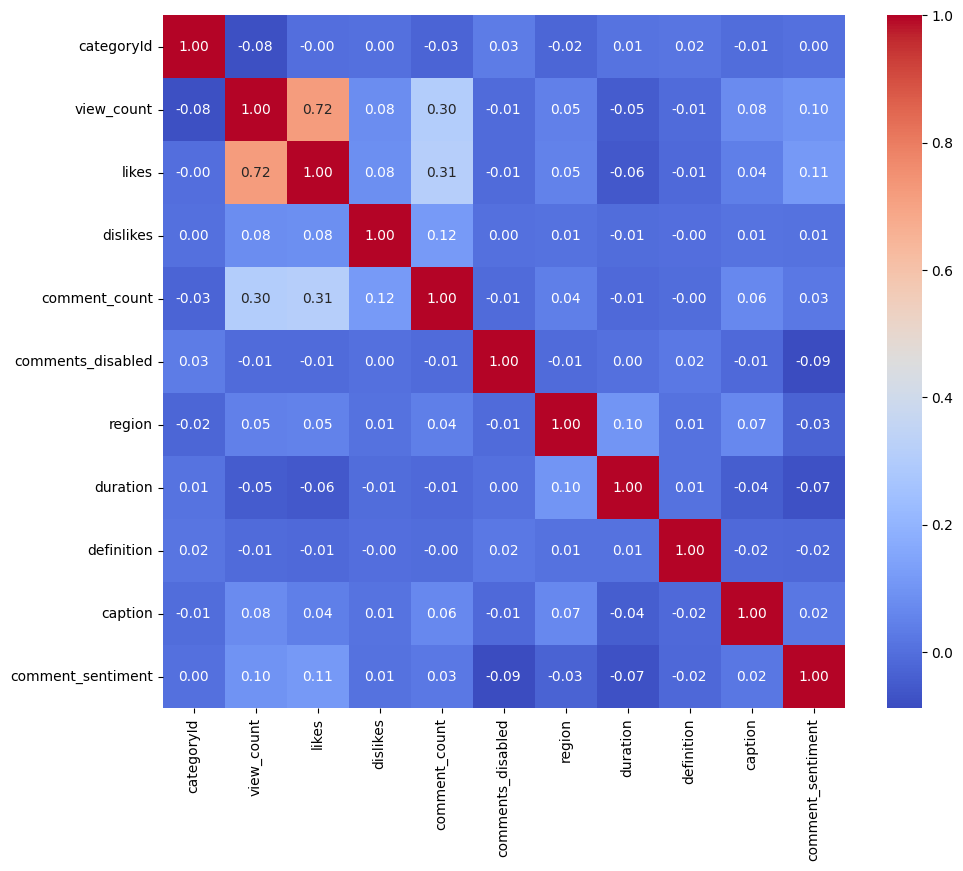

In [3]:
# visulize the dataset
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# label encode categorical columns
label_encoders = {}
for column in complete_dataset.columns:
    if complete_dataset[column].dtype == 'object':
        label_encoder = LabelEncoder()
        complete_dataset[column] = label_encoder.fit_transform(complete_dataset[column])
        label_encoders[column] = label_encoder

# Create a correlation matrix of the first 11 columns of the dataset
corr = complete_dataset.iloc[:, :11].corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap='coolwarm', annot=True, fmt=".2f")

plt.show()



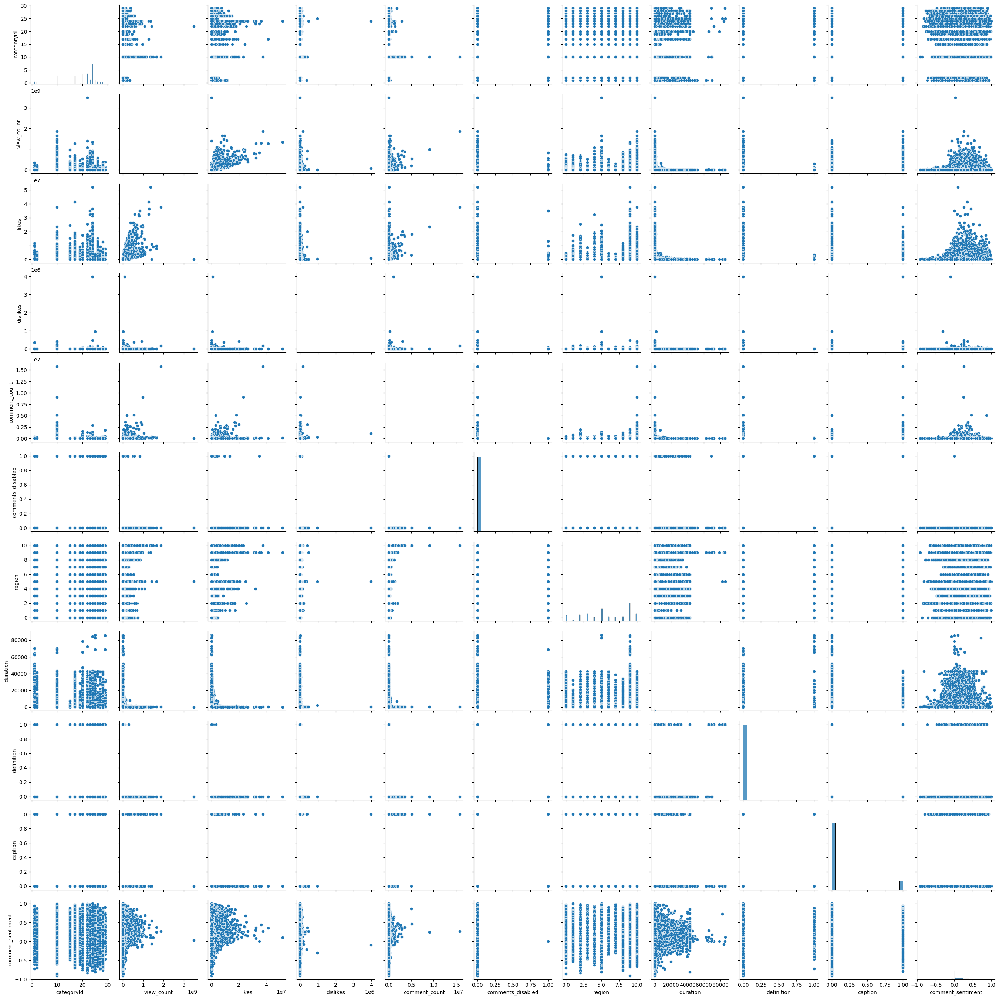

In [22]:
# pair plots of first 11 columns
sns.pairplot(complete_dataset.iloc[:, :11])
plt.show()

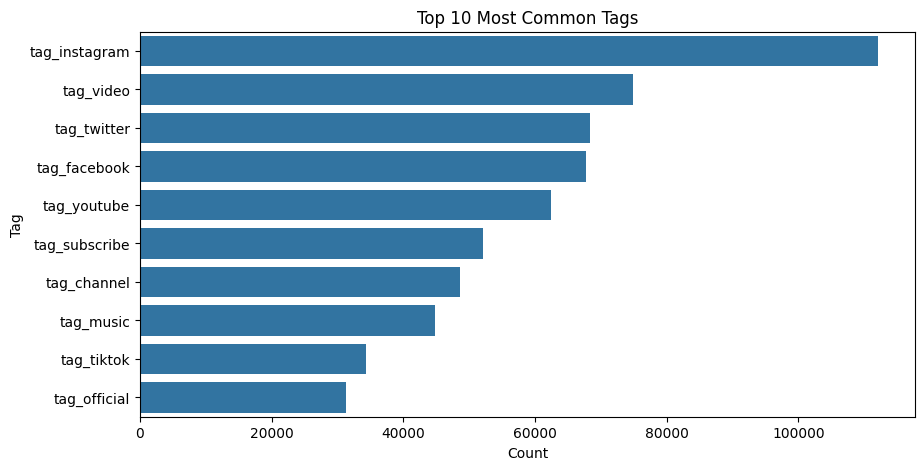

In [24]:


tag_counts = complete_dataset.iloc[:, 11:].sum(axis=0)
tag_counts = tag_counts.sort_values(ascending=False)

# Plot the top 10 most common tags
plt.figure(figsize=(10, 5))
sns.barplot(x=tag_counts.values[:10], y=tag_counts.index[:10])
plt.title('Top 10 Most Common Tags')
plt.xlabel('Count')
plt.ylabel('Tag')
plt.show()


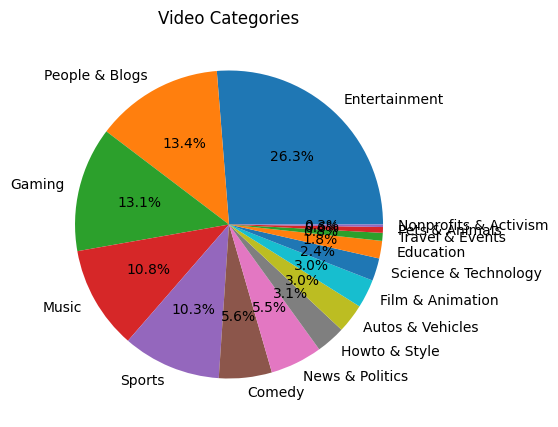

In [27]:
category_mapping = {
    2: "Autos & Vehicles",
    1: "Film & Animation",
    10: "Music",
    15: "Pets & Animals",
    17: "Sports",
    18: "Short Movies",
    19: "Travel & Events",
    20: "Gaming",
    21: "Videoblogging",
    22: "People & Blogs",
    23: "Comedy",
    24: "Entertainment",
    25: "News & Politics",
    26: "Howto & Style",
    27: "Education",
    28: "Science & Technology",
    29: "Nonprofits & Activism",
    30: "Movies",
    31: "Anime/Animation",
    32: "Action/Adventure",
    33: "Classics",
    34: "Comedy",
    35: "Documentary",
    36: "Drama",
    37: "Family",
    38: "Foreign",
    39: "Horror",
    40: "Sci-Fi/Fantasy",
    41: "Thriller",
    42: "Shorts",
    43: "Shows",
    44: "Trailers"
}

# make pi chart according to definition
definition_counts = complete_dataset['categoryId'].value_counts()
labels = [category_mapping.get(cat_id, "Unknown") for cat_id in definition_counts.index]
plt.figure(figsize=(10, 5))
plt.pie(definition_counts, labels=labels, autopct='%1.1f%%')
plt.title('Video Categories')
plt.show()


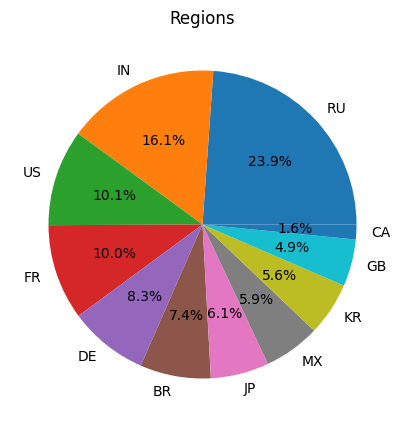

In [5]:
# pi chart for region
region_counts = complete_dataset['region'].value_counts()
regions = [label_encoders['region'].inverse_transform([region])[0] for region in region_counts.index]
plt.figure(figsize=(10, 5))
plt.pie(region_counts, labels=regions, autopct='%1.1f%%')
plt.title('Regions')
plt.show()


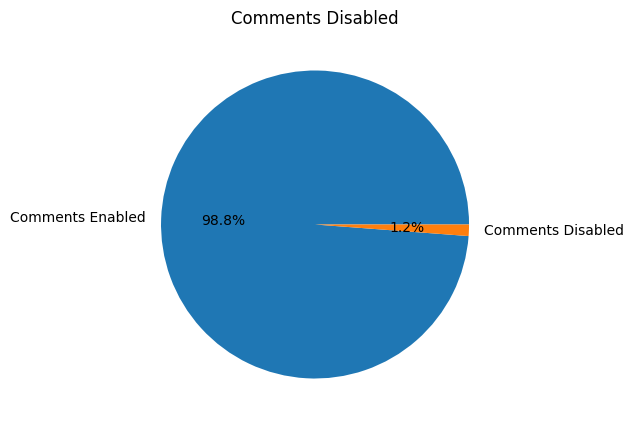

In [6]:
# pi chart for total videos with comments disabled
comments_disabled_counts = complete_dataset['comments_disabled'].value_counts()
plt.figure(figsize=(10, 5))
plt.pie(comments_disabled_counts, labels=['Comments Enabled', 'Comments Disabled'], autopct='%1.1f%%')
plt.title('Comments Disabled')
plt.show()

In [8]:
complete_dataset.describe()

,categoryId,view_count,likes,dislikes,comment_count,region,duration,definition,comment_sentiment,tag_instagram,...,tag_production,tag_spotify,tag_funny,tag_design,tag_download,tag_merch,tag_family,tag_challenge,tag_comedy,tag_digital
count,450731.000000,4.507310e+05,4.507310e+05,4.507310e+05,4.507310e+05,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,...,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000,450731.000000
mean,19.734764,5.016213e+06,1.256398e+05,3.502586e+02,4.035947e+03,5.877983,1294.606863,0.004486,0.155686,0.248736,...,0.027835,0.021656,0.031402,0.017649,0.029827,0.024602,0.033035,0.027074,0.034535,0.018956
std,6.551173,2.379317e+07,5.177033e+05,6.478964e+03,3.784381e+04,3.114976,3017.209399,0.066828,0.193607,0.432281,...,0.164499,0.145558,0.174403,0.131673,0.170110,0.154910,0.178729,0.162299,0.182599,0.136369
min,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,-0.911910,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,3.951655e+05,1.039700e+04,0.000000e+00,4.420000e+02,3.000000,220.000000,0.000000,0.001735,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,22.000000,1.057772e+06,2.823200e+04,0.000000e+00,1.150000e+03,6.000000,668.000000,0.000000,0.122740,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,24.000000,2.940004e+06,8.188250e+04,1.500000e+02,2.958000e+03,9.000000,1225.000000,0.000000,0.270210,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,29.000000,3.487457e+09,5.196805e+07,3.979409e+06,1.580316e+07,10.000000,86182.000000,1.000000,0.999970,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
